# EDA


# Import Libraries

In [0]:
from pyspark.sql.functions import lit, col, desc, to_date, length, count, when, hour, dayofweek, round, explode, lower, udf
from pyspark.sql.types import ArrayType, StringType
from pyspark.ml.feature import VectorAssembler, BucketedRandomProjectionLSH
from pyspark.sql.functions import col, count, desc, lit, coalesce, row_number
from pyspark.sql import functions as F
from pyspark.sql import SparkSession
from pyspark.sql.functions import round as spark_round
from pyspark.sql.window import Window
from pyspark.sql import DataFrame
from pyspark.sql.functions import floor
from pyspark.sql.functions import monotonically_increasing_id
import plotly.express as px



import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
import plotly.express as px
from sklearn.impute import KNNImputer
from functools import reduce

import re



In [0]:
# Initialize Spark session
spark = SparkSession.builder.appName("EDA").getOrCreate()

# Import CSV

In [0]:
# File location and type
flights_file_location = "/FileStore/tables/flights.csv"
file_type = "csv"

# CSV options
infer_schema = "true"
first_row_is_header = "true"
delimiter = ","


df = (
    spark.read.format(file_type)
    .option("inferSchema", infer_schema)
    .option("header", first_row_is_header)
    .option("sep", delimiter)
    .option("quote", '"') # To handle commas correctly
    .option("escape", '"')
    .option("multiLine", "true")  # Allow fields to span multiple lines (helps with complex quoted fields)
    .option("mode", "PERMISSIVE") # Avoid failing on corrupt records
    .load(flights_file_location)
)


# Display result
display(df)

YEAR,MONTH,DAY,DAY_OF_WEEK,AIRLINE,FLIGHT_NUMBER,TAIL_NUMBER,ORIGIN_AIRPORT,DESTINATION_AIRPORT,SCHEDULED_DEPARTURE,DEPARTURE_TIME,DEPARTURE_DELAY,TAXI_OUT,WHEELS_OFF,SCHEDULED_TIME,ELAPSED_TIME,AIR_TIME,DISTANCE,WHEELS_ON,TAXI_IN,SCHEDULED_ARRIVAL,ARRIVAL_TIME,ARRIVAL_DELAY,DIVERTED,CANCELLED,CANCELLATION_REASON,AIR_SYSTEM_DELAY,SECURITY_DELAY,AIRLINE_DELAY,LATE_AIRCRAFT_DELAY,WEATHER_DELAY
2015,1,1,4,AS,98,N407AS,ANC,SEA,5,2354,-11,21,15,205,194,169,1448,404,4,430,408,-22,0,0,null,null,null,null,null,null
2015,1,1,4,AA,2336,N3KUAA,LAX,PBI,10,2,-8,12,14,280,279,263,2330,737,4,750,741,-9,0,0,null,null,null,null,null,null
2015,1,1,4,US,840,N171US,SFO,CLT,20,18,-2,16,34,286,293,266,2296,800,11,806,811,5,0,0,null,null,null,null,null,null
2015,1,1,4,AA,258,N3HYAA,LAX,MIA,20,15,-5,15,30,285,281,258,2342,748,8,805,756,-9,0,0,null,null,null,null,null,null
2015,1,1,4,AS,135,N527AS,SEA,ANC,25,24,-1,11,35,235,215,199,1448,254,5,320,259,-21,0,0,null,null,null,null,null,null
2015,1,1,4,DL,806,N3730B,SFO,MSP,25,20,-5,18,38,217,230,206,1589,604,6,602,610,8,0,0,null,null,null,null,null,null
2015,1,1,4,NK,612,N635NK,LAS,MSP,25,19,-6,11,30,181,170,154,1299,504,5,526,509,-17,0,0,null,null,null,null,null,null
2015,1,1,4,US,2013,N584UW,LAX,CLT,30,44,14,13,57,273,249,228,2125,745,8,803,753,-10,0,0,null,null,null,null,null,null
2015,1,1,4,AA,1112,N3LAAA,SFO,DFW,30,19,-11,17,36,195,193,173,1464,529,3,545,532,-13,0,0,null,null,null,null,null,null
2015,1,1,4,DL,1173,N826DN,LAS,ATL,30,33,3,12,45,221,203,186,1747,651,5,711,656,-15,0,0,null,null,null,null,null,null


# Filter the dataset

In [0]:
# Count total number of rows in the DataFrame
total = df.count()

# Create expressions to calculate % of missing values per column (rounded to 2 decimals)
exprs = [
    round((count(when(col(c).isNull(), c)) / total * 100), 2).alias(c)
    for c in df.columns
]

# Compute missing % for all columns in a single pass (1-row DataFrame)
missing_percent_row = df.select(exprs)

# Reshape the wide 1-row DataFrame into a long format - column and missing_percent
missing_df = missing_percent_row.selectExpr(
    f"stack({len(df.columns)}, " +
    ", ".join([f"'{c}', `{c}`" for c in df.columns]) +
    ") as (column, missing_percent)"
)

# Sort the results by missing percentage (descendent)
missing_df = missing_df.orderBy(col("missing_percent").desc())

# Display result
print("Df - Missing Percentages")
display(missing_df)

Df - Missing Percentages


column,missing_percent
CANCELLATION_REASON,98.46
AIR_SYSTEM_DELAY,81.72
SECURITY_DELAY,81.72
AIRLINE_DELAY,81.72
LATE_AIRCRAFT_DELAY,81.72
WEATHER_DELAY,81.72
ELAPSED_TIME,1.81
AIR_TIME,1.81
ARRIVAL_DELAY,1.81
WHEELS_ON,1.59


In [0]:
# Create filtered DataFrame with non-null country
filtered_df = df.filter(col("AIR_SYSTEM_DELAY").isNotNull() & col("LATE_AIRCRAFT_DELAY").isNotNull() & col("SECURITY_DELAY").isNotNull() & col("AIRLINE_DELAY").isNotNull()  & col("LATE_AIRCRAFT_DELAY").isNotNull() & col("WEATHER_DELAY").isNotNull())

# Display result
display(filtered_df)

YEAR,MONTH,DAY,DAY_OF_WEEK,AIRLINE,FLIGHT_NUMBER,TAIL_NUMBER,ORIGIN_AIRPORT,DESTINATION_AIRPORT,SCHEDULED_DEPARTURE,DEPARTURE_TIME,DEPARTURE_DELAY,TAXI_OUT,WHEELS_OFF,SCHEDULED_TIME,ELAPSED_TIME,AIR_TIME,DISTANCE,WHEELS_ON,TAXI_IN,SCHEDULED_ARRIVAL,ARRIVAL_TIME,ARRIVAL_DELAY,DIVERTED,CANCELLED,CANCELLATION_REASON,AIR_SYSTEM_DELAY,SECURITY_DELAY,AIRLINE_DELAY,LATE_AIRCRAFT_DELAY,WEATHER_DELAY
2015,1,1,4,NK,597,N528NK,MSP,FLL,115,127,12,14,141,207,220,166,1487,527,40,542,607,25,0,0,null,25,0,0,0,0
2015,1,1,4,NK,168,N629NK,PHX,ORD,125,237,72,9,246,204,175,156,1440,622,10,549,632,43,0,0,null,43,0,0,0,0
2015,1,1,4,HA,17,N389HA,LAS,HNL,145,145,0,16,201,370,385,361,2762,602,8,555,610,15,0,0,null,0,0,15,0,0
2015,1,1,4,B6,1030,N239JB,BQN,MCO,307,304,-3,25,329,173,196,160,1129,509,11,500,520,20,0,0,null,20,0,0,0,0
2015,1,1,4,B6,2134,N307JB,SJU,MCO,400,535,95,9,544,185,175,163,1189,727,3,605,730,85,0,0,null,0,0,85,0,0
2015,1,1,4,B6,2276,N646JB,SJU,BDL,438,550,72,15,605,241,258,237,1666,902,6,739,908,89,0,0,null,17,0,72,0,0
2015,1,1,4,AA,1057,N3ASAA,DFW,MIA,515,703,108,15,718,161,155,133,1121,1031,7,856,1038,102,0,0,null,0,0,0,0,102
2015,1,1,4,US,425,N174US,PDX,PHX,520,620,60,13,633,150,150,132,1009,945,5,850,950,60,0,0,null,0,0,60,0,0
2015,1,1,4,AA,89,N3KVAA,IAH,MIA,520,618,58,19,637,141,137,111,964,928,7,841,935,54,0,0,null,0,0,54,0,0
2015,1,1,4,AA,328,N4XKAA,DEN,DFW,530,623,53,32,655,125,138,96,641,931,10,835,941,66,0,0,null,13,0,53,0,0


In [0]:
# Count total number of rows in the DataFrame
total_filtered = filtered_df.count()

# Create expressions to calculate % of missing values per column
exprs_filtered = [
    round((count(when(col(c).isNull(), c)) / total * 100), 2).alias(c)
    for c in filtered_df.columns
]

# Compute missing % for all columns
missing_percent_row_filtered = filtered_df.select(exprs)

# Reshape the wide 1-row DataFrame into a long format - column and missing_percent
missing_filtered_df = missing_percent_row_filtered.selectExpr(
    f"stack({len(filtered_df.columns)}, " +
    ", ".join([f"'{c}', `{c}`" for c in filtered_df.columns]) +
    ") as (column, missing_percent)"
)

# Sort the results by missing percentage
missing_filtered_df = missing_filtered_df.orderBy(col("missing_percent").desc())

# Display result
print("Filtered Df - Missing Percentages")
display(missing_filtered_df)

Filtered Df - Missing Percentages


column,missing_percent
CANCELLATION_REASON,18.28
YEAR,0.0
MONTH,0.0
DAY,0.0
DAY_OF_WEEK,0.0
AIRLINE,0.0
FLIGHT_NUMBER,0.0
TAIL_NUMBER,0.0
ORIGIN_AIRPORT,0.0
DESTINATION_AIRPORT,0.0


In [0]:
# Count rows in each DataFrame
total_rows = df.count()
filtered_rows = filtered_df.count()

# Calculate difference
dropped_rows = total_rows - filtered_rows
dropped_percentage = (dropped_rows / total_rows) * 100

# Print the results
print(f"Rows after filtering (filtered_df): {filtered_rows}")

Rows after filtering (filtered_df): 1063439


In [0]:
data = filtered_df.withColumn("index", monotonically_increasing_id())

In [0]:
display(data)

YEAR,MONTH,DAY,DAY_OF_WEEK,AIRLINE,FLIGHT_NUMBER,TAIL_NUMBER,ORIGIN_AIRPORT,DESTINATION_AIRPORT,SCHEDULED_DEPARTURE,DEPARTURE_TIME,DEPARTURE_DELAY,TAXI_OUT,WHEELS_OFF,SCHEDULED_TIME,ELAPSED_TIME,AIR_TIME,DISTANCE,WHEELS_ON,TAXI_IN,SCHEDULED_ARRIVAL,ARRIVAL_TIME,ARRIVAL_DELAY,DIVERTED,CANCELLED,CANCELLATION_REASON,AIR_SYSTEM_DELAY,SECURITY_DELAY,AIRLINE_DELAY,LATE_AIRCRAFT_DELAY,WEATHER_DELAY,index
2015,1,1,4,NK,597,N528NK,MSP,FLL,115,127,12,14,141,207,220,166,1487,527,40,542,607,25,0,0,null,25,0,0,0,0,0
2015,1,1,4,NK,168,N629NK,PHX,ORD,125,237,72,9,246,204,175,156,1440,622,10,549,632,43,0,0,null,43,0,0,0,0,1
2015,1,1,4,HA,17,N389HA,LAS,HNL,145,145,0,16,201,370,385,361,2762,602,8,555,610,15,0,0,null,0,0,15,0,0,2
2015,1,1,4,B6,1030,N239JB,BQN,MCO,307,304,-3,25,329,173,196,160,1129,509,11,500,520,20,0,0,null,20,0,0,0,0,3
2015,1,1,4,B6,2134,N307JB,SJU,MCO,400,535,95,9,544,185,175,163,1189,727,3,605,730,85,0,0,null,0,0,85,0,0,4
2015,1,1,4,B6,2276,N646JB,SJU,BDL,438,550,72,15,605,241,258,237,1666,902,6,739,908,89,0,0,null,17,0,72,0,0,5
2015,1,1,4,AA,1057,N3ASAA,DFW,MIA,515,703,108,15,718,161,155,133,1121,1031,7,856,1038,102,0,0,null,0,0,0,0,102,6
2015,1,1,4,US,425,N174US,PDX,PHX,520,620,60,13,633,150,150,132,1009,945,5,850,950,60,0,0,null,0,0,60,0,0,7
2015,1,1,4,AA,89,N3KVAA,IAH,MIA,520,618,58,19,637,141,137,111,964,928,7,841,935,54,0,0,null,0,0,54,0,0,8
2015,1,1,4,AA,328,N4XKAA,DEN,DFW,530,623,53,32,655,125,138,96,641,931,10,835,941,66,0,0,null,13,0,53,0,0,9


In [0]:
filtered_df.write.mode("overwrite").option("header", True).csv("/dbfs/FileStore/exports/filtered_df.csv")

# Overview

- YEAR, MONTH, DAY, DAY_OF_WEEK: dates of the flight
- AIRLINE: Identification number assigned by US DOT to identify a unique airline
- ORIGIN_AIRPORT and DESTINATION_AIRPORT: code attributed by IATA to identify the airports
- SCHEDULED_DEPARTURE and SCHEDULED_ARRIVAL : scheduled times of take-off and landing
- DEPARTURE_TIME and ARRIVAL_TIME: real times at which take-off and landing took place
- DEPARTURE_DELAY and ARRIVAL_DELAY: difference (in minutes) between planned and real times
- DISTANCE: distance (in miles)


### Duplicates

In [0]:
display(data.groupBy(df.columns).count().filter("count > 1"))

YEAR,MONTH,DAY,DAY_OF_WEEK,AIRLINE,FLIGHT_NUMBER,TAIL_NUMBER,ORIGIN_AIRPORT,DESTINATION_AIRPORT,SCHEDULED_DEPARTURE,DEPARTURE_TIME,DEPARTURE_DELAY,TAXI_OUT,WHEELS_OFF,SCHEDULED_TIME,ELAPSED_TIME,AIR_TIME,DISTANCE,WHEELS_ON,TAXI_IN,SCHEDULED_ARRIVAL,ARRIVAL_TIME,ARRIVAL_DELAY,DIVERTED,CANCELLED,CANCELLATION_REASON,AIR_SYSTEM_DELAY,SECURITY_DELAY,AIRLINE_DELAY,LATE_AIRCRAFT_DELAY,WEATHER_DELAY,count


There are no duplicates in our partition of the dataset.

In [0]:
cols = ["YEAR", "MONTH", "DAY", "AIRLINE", "FLIGHT_NUMBER", "TAIL_NUMBER", "SCHEDULED_DEPARTURE"]

display(data.groupBy(cols).count().filter("count > 1"))

YEAR,MONTH,DAY,AIRLINE,FLIGHT_NUMBER,TAIL_NUMBER,SCHEDULED_DEPARTURE,count


Although we have flight numbers that are repeated none of them is on the same day of the same month, so it is likely that these are recurrent flights: no anomalies in this

### Top Origin Airports

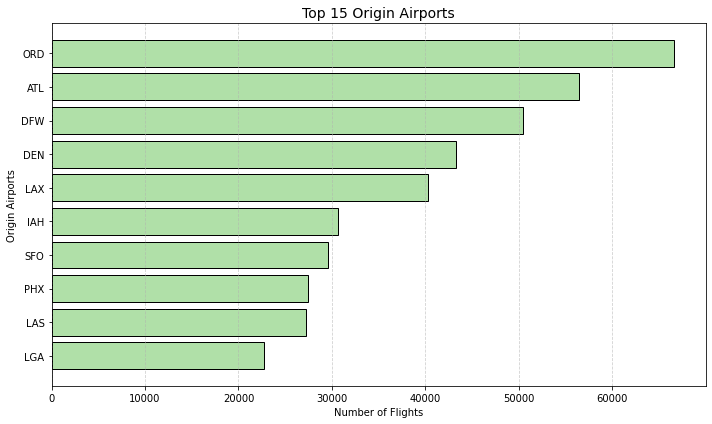

In [0]:
# Top sources
sources = filtered_df.groupBy("ORIGIN_AIRPORT").count().orderBy(desc("count")).limit(10)
sources_pd = sources.toPandas()

sources_pd = sources_pd.sort_values("count", ascending=True)

plt.figure(figsize=(10, 6))
plt.barh(sources_pd["ORIGIN_AIRPORT"], sources_pd["count"], color="#b0e0a8", edgecolor='black')

plt.title("Top 15 Origin Airports", fontsize=14)
plt.xlabel("Number of Flights")
plt.ylabel("Origin Airports")
plt.grid(axis='x', linestyle='--', alpha=0.6)
plt.tight_layout()
plt.show()

### Top Destination Airports

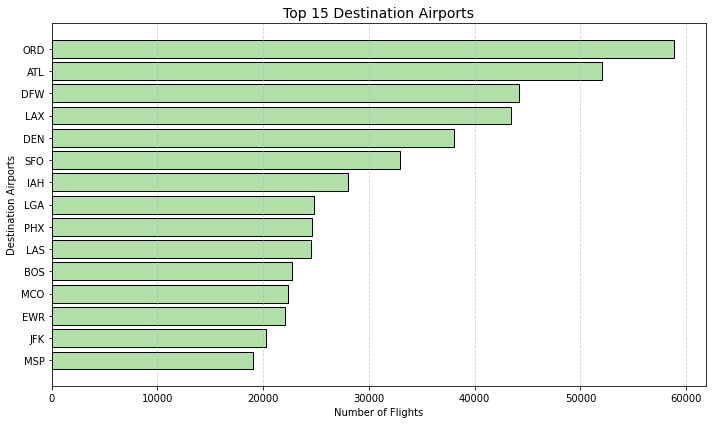

In [0]:
# Top destinations
destinations = filtered_df.groupBy("DESTINATION_AIRPORT").count().orderBy(desc("count")).limit(15)
destinations_pd = destinations.toPandas()

destinations_pd = destinations_pd.sort_values("count", ascending=True)

plt.figure(figsize=(10, 6))
plt.barh(destinations_pd["DESTINATION_AIRPORT"], destinations_pd["count"], color="#b0e0a8", edgecolor='black')

plt.title("Top 15 Destination Airports", fontsize=14)
plt.xlabel("Number of Flights")
plt.ylabel("Destination Airports")
plt.grid(axis='x', linestyle='--', alpha=0.6)
plt.tight_layout()
plt.show()

### Top Airlines

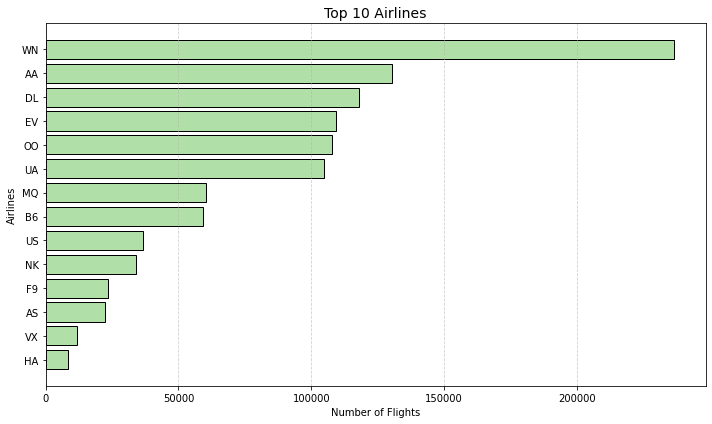

In [0]:
# Top airlines
destinations = filtered_df.groupBy("AIRLINE").count().orderBy(desc("count")).limit(15)
destinations_pd = destinations.toPandas()

destinations_pd = destinations_pd.sort_values("count", ascending=True)

plt.figure(figsize=(10, 6))
plt.barh(destinations_pd["AIRLINE"], destinations_pd["count"], color="#b0e0a8", edgecolor='black')

plt.title("Top 10 Airlines", fontsize=14)
plt.xlabel("Number of Flights")
plt.ylabel("Airlines")
plt.grid(axis='x', linestyle='--', alpha=0.6)
plt.tight_layout()
plt.show()

### Delays by Airlines

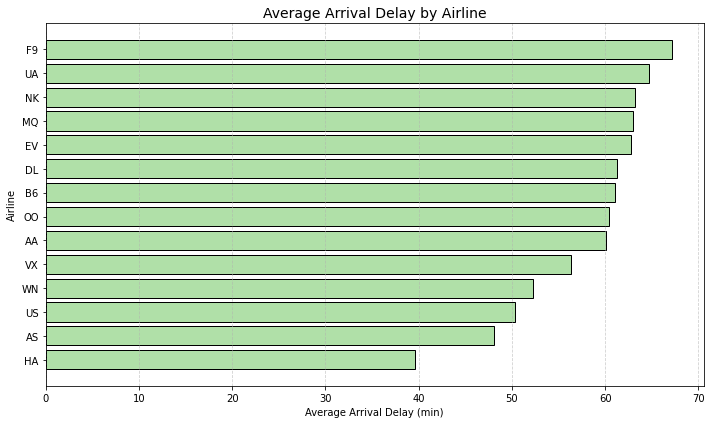

In [0]:
delays = filtered_df.groupBy("AIRLINE").avg("ARRIVAL_DELAY").orderBy("avg(ARRIVAL_DELAY)", ascending=True)
delays_pd = delays.toPandas()

plt.figure(figsize=(10, 6))
plt.barh(delays_pd["AIRLINE"], delays_pd["avg(ARRIVAL_DELAY)"], color="#b0e0a8", edgecolor='black')

plt.title("Average Arrival Delay by Airline", fontsize=14)
plt.xlabel("Average Arrival Delay (min)")
plt.ylabel("Airline")
plt.grid(axis='x', linestyle='--', alpha=0.6)
plt.tight_layout()
plt.show()

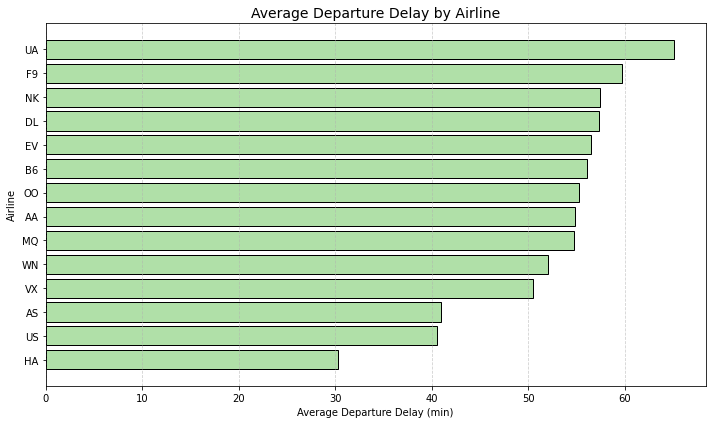

In [0]:
delays = filtered_df.groupBy("AIRLINE").avg("DEPARTURE_DELAY").orderBy("avg(DEPARTURE_DELAY)", ascending=True)
delays_pd = delays.toPandas()

plt.figure(figsize=(10, 6))
plt.barh(delays_pd["AIRLINE"], delays_pd["avg(DEPARTURE_DELAY)"], color="#b0e0a8", edgecolor='black')

plt.title("Average Departure Delay by Airline", fontsize=14)
plt.xlabel("Average Departure Delay (min)")
plt.ylabel("Airline")
plt.grid(axis='x', linestyle='--', alpha=0.6)
plt.tight_layout()
plt.show()

<command-319059098806948>:17: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax3.set_xticklabels(['{:2.0f}h{:02.0f}m'.format(*divmod(x, 60))


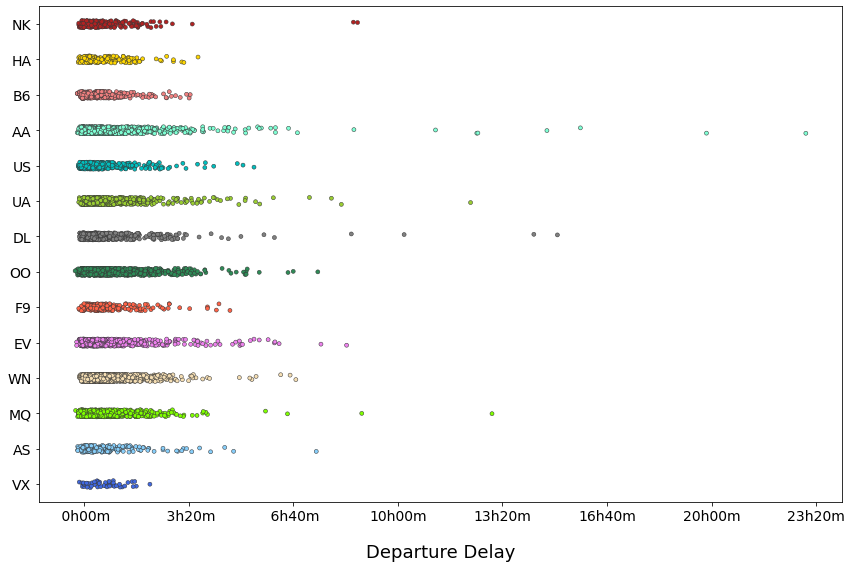

In [0]:
df2 = filtered_df.select("AIRLINE", "DEPARTURE_DELAY") \
    .dropna(subset=["AIRLINE", "DEPARTURE_DELAY"]) \
    .limit(10000)  

df2_pd = df2.toPandas()

colors = ['firebrick', 'gold', 'lightcoral', 'aquamarine', 'c', 'yellowgreen', 'grey',
          'seagreen', 'tomato', 'violet', 'wheat', 'chartreuse', 'lightskyblue', 'royalblue']

plt.figure(figsize=(12, 8))
ax3 = sns.stripplot(y="AIRLINE", x="DEPARTURE_DELAY", size=4, palette=colors,
                    data=df2_pd, linewidth=0.5, jitter=True)

plt.setp(ax3.get_xticklabels(), fontsize=14)
plt.setp(ax3.get_yticklabels(), fontsize=14)

ax3.set_xticklabels(['{:2.0f}h{:02.0f}m'.format(*divmod(x, 60))
                     for x in ax3.get_xticks()])

plt.xlabel('Departure Delay', fontsize=18,
           color='black', labelpad=20)
ax3.yaxis.label.set_visible(False)

plt.tight_layout(w_pad=3)
plt.show()

### Daily and Weeekly Activity

In [0]:
df_hour = filtered_df.withColumn("HOUR", floor(col("SCHEDULED_DEPARTURE") / 100))
avg_delay_hour = df_hour.groupBy("HOUR").avg("DEPARTURE_DELAY").orderBy("HOUR").toPandas()

fig = px.line(
    avg_delay_hour,
    x="HOUR",
    y="avg(DEPARTURE_DELAY)",
    markers=True,
    title="Average Departure Delay by Hour",
    labels={
        "HOUR": "Hour (24h format)",
        "avg(DEPARTURE_DELAY)": "Average Delay (min)"
    }
)

fig.update_layout(
    template="plotly_white",
    title_font=dict(size=22),
    xaxis=dict(
        dtick=1,
        tickmode='linear',
        range=[-1, 24],
        tickfont=dict(size=12),
        title_font=dict(size=16),
        title_standoff=10
    ),
    yaxis=dict(
        range=[0, avg_delay_hour["avg(DEPARTURE_DELAY)"].max() * 1.1],
        tickfont=dict(size=12),
        title_font=dict(size=16)
    ),
    margin=dict(l=40, r=40, t=60, b=40),
    hovermode="x unified"
)

fig.show()


### Take-off vs landing delays

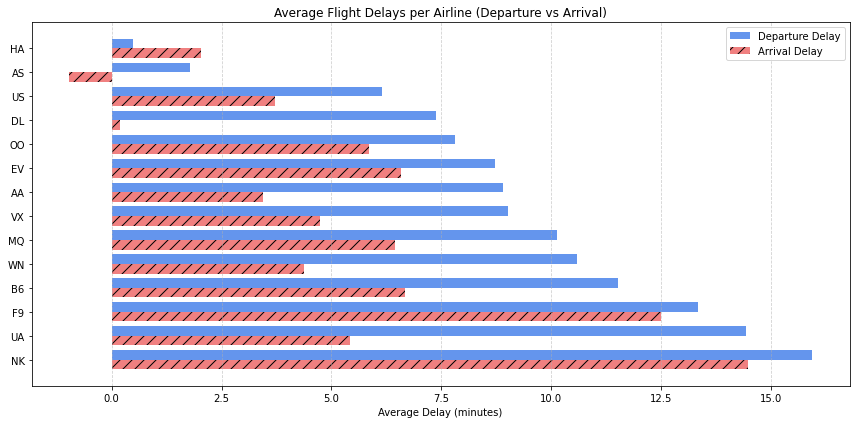

In [0]:
df_avg = (
    df.groupBy("AIRLINE")
      .agg(
          F.avg("DEPARTURE_DELAY").alias("avg_departure_delay"),
          F.avg("ARRIVAL_DELAY").alias("avg_arrival_delay")
      )
      .orderBy("avg_departure_delay", ascending=False)
)

pdf = df_avg.toPandas()

airlines = pdf["AIRLINE"]
x1 = pdf["avg_departure_delay"]
x2 = pdf["avg_arrival_delay"]
y = range(len(airlines))

bar_width = 0.4
plt.figure(figsize=(12, 6))
plt.barh([i + bar_width/2 for i in y], x1, height=bar_width, color="cornflowerblue", label="Departure Delay")
plt.barh([i - bar_width/2 for i in y], x2, height=bar_width, color="lightcoral", label="Arrival Delay", hatch='//')

plt.yticks(y, airlines)
plt.xlabel("Average Delay (minutes)")
plt.title("Average Flight Delays per Airline (Departure vs Arrival)")
plt.legend()
plt.grid(axis='x', linestyle='--', alpha=0.6)
plt.tight_layout()
plt.show()


### Routes Delays

In [0]:
display(df.groupBy("ORIGIN_AIRPORT", "DESTINATION_AIRPORT") \
  .count() \
  .orderBy("count", ascending=False)
)

ORIGIN_AIRPORT,DESTINATION_AIRPORT,count
SFO,LAX,13744
LAX,SFO,13457
JFK,LAX,12016
LAX,JFK,12015
LAS,LAX,9715
LGA,ORD,9639
LAX,LAS,9594
ORD,LGA,9575
SFO,JFK,8440
JFK,SFO,8437


In [0]:
display(df.groupBy("ORIGIN_AIRPORT") \
  .count() \
  .orderBy("count", ascending=False))

ORIGIN_AIRPORT,count
ATL,346836
ORD,285884
DFW,239551
DEN,196055
LAX,194673
SFO,148008
PHX,146815
IAH,146622
LAS,133181
MSP,112117


In [0]:
display(df.groupBy("DESTINATION_AIRPORT") \
  .count() \
  .orderBy("count", ascending=False))

DESTINATION_AIRPORT,count
ATL,346904
ORD,285906
DFW,239582
DEN,196010
LAX,194696
SFO,147966
PHX,146812
IAH,146683
LAS,133198
MSP,112128


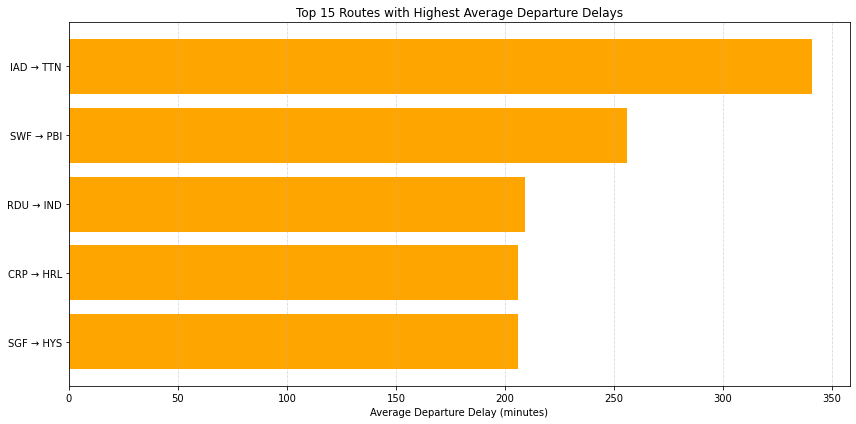

In [0]:
df_routes = df.withColumn(
    "ROUTE", F.concat_ws(" → ", F.col("ORIGIN_AIRPORT"), F.col("DESTINATION_AIRPORT"))
)

df_delays_by_route = (
    df_routes.groupBy("ROUTE")
    .agg(F.avg("DEPARTURE_DELAY").alias("avg_departure_delay"))
    .orderBy(F.desc("avg_departure_delay"))
    .limit(5)  
)

pdf_routes = df_delays_by_route.toPandas()

plt.figure(figsize=(12, 6))
plt.barh(pdf_routes["ROUTE"], pdf_routes["avg_departure_delay"], color="orange")
plt.xlabel("Average Departure Delay (minutes)")
plt.title("Top 15 Routes with Highest Average Departure Delays")
plt.gca().invert_yaxis()
plt.grid(axis='x', linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()


### Correlation Matrix

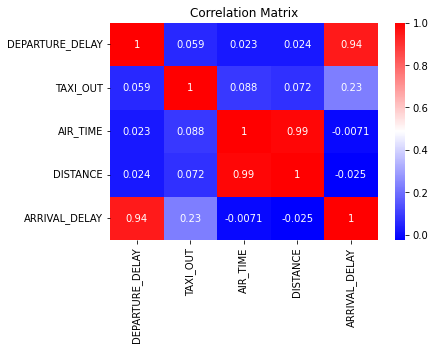

In [0]:
numeric_cols = ["DEPARTURE_DELAY", "TAXI_OUT", "AIR_TIME", "DISTANCE", "ARRIVAL_DELAY" ]
df_pd = df.select(*numeric_cols).toPandas()

sns.heatmap(df_pd.corr(), annot=True, cmap="bwr")
plt.title("Correlation Matrix")
plt.show()


# Export Dataframe

In [0]:
# Export the DataFrame as a Delta table
filtered_df.write.mode("overwrite") \
    .option("overwriteSchema", "true") \
    .format("delta") \
    .save("/dbfs/FileStore/tables/df_eda")

In [0]:
filtered_df.display()

YEAR,MONTH,DAY,DAY_OF_WEEK,AIRLINE,FLIGHT_NUMBER,TAIL_NUMBER,ORIGIN_AIRPORT,DESTINATION_AIRPORT,SCHEDULED_DEPARTURE,DEPARTURE_TIME,DEPARTURE_DELAY,TAXI_OUT,WHEELS_OFF,SCHEDULED_TIME,ELAPSED_TIME,AIR_TIME,DISTANCE,WHEELS_ON,TAXI_IN,SCHEDULED_ARRIVAL,ARRIVAL_TIME,ARRIVAL_DELAY,DIVERTED,CANCELLED,CANCELLATION_REASON,AIR_SYSTEM_DELAY,SECURITY_DELAY,AIRLINE_DELAY,LATE_AIRCRAFT_DELAY,WEATHER_DELAY
2015,1,1,4,NK,597,N528NK,MSP,FLL,115,127,12,14,141,207,220,166,1487,527,40,542,607,25,0,0,null,25,0,0,0,0
2015,1,1,4,NK,168,N629NK,PHX,ORD,125,237,72,9,246,204,175,156,1440,622,10,549,632,43,0,0,null,43,0,0,0,0
2015,1,1,4,HA,17,N389HA,LAS,HNL,145,145,0,16,201,370,385,361,2762,602,8,555,610,15,0,0,null,0,0,15,0,0
2015,1,1,4,B6,1030,N239JB,BQN,MCO,307,304,-3,25,329,173,196,160,1129,509,11,500,520,20,0,0,null,20,0,0,0,0
2015,1,1,4,B6,2134,N307JB,SJU,MCO,400,535,95,9,544,185,175,163,1189,727,3,605,730,85,0,0,null,0,0,85,0,0
2015,1,1,4,B6,2276,N646JB,SJU,BDL,438,550,72,15,605,241,258,237,1666,902,6,739,908,89,0,0,null,17,0,72,0,0
2015,1,1,4,AA,1057,N3ASAA,DFW,MIA,515,703,108,15,718,161,155,133,1121,1031,7,856,1038,102,0,0,null,0,0,0,0,102
2015,1,1,4,US,425,N174US,PDX,PHX,520,620,60,13,633,150,150,132,1009,945,5,850,950,60,0,0,null,0,0,60,0,0
2015,1,1,4,AA,89,N3KVAA,IAH,MIA,520,618,58,19,637,141,137,111,964,928,7,841,935,54,0,0,null,0,0,54,0,0
2015,1,1,4,AA,328,N4XKAA,DEN,DFW,530,623,53,32,655,125,138,96,641,931,10,835,941,66,0,0,null,13,0,53,0,0
